In [ ]:
!cp -r drive/MyDrive/COCO_cars/* .

In [ ]:
!pip install pycocotools

In [ ]:
import os

In [ ]:
!wget https://raw.githubusercontent.com/pytorch/vision/main/references/detection/engine.py
!wget https://raw.githubusercontent.com/pytorch/vision/main/references/detection/utils.py
!wget https://raw.githubusercontent.com/pytorch/vision/main/references/detection/coco_utils.py
!wget https://raw.githubusercontent.com/pytorch/vision/main/references/detection/coco_eval.py
!wget https://raw.githubusercontent.com/pytorch/vision/main/references/detection/transforms.py

In [ ]:
from engine import evaluate

In [ ]:
import torch
from torch.utils.data import Dataset
from pycocotools.coco import COCO
from PIL import Image
from torch.utils.data import DataLoader
import torchvision.transforms as T

In [ ]:
from torchvision.datasets import CocoDetection

In [ ]:
from torchvision import models
from tqdm.notebook import tqdm
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches

from pycocotools.cocoeval import COCOeval

from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
import json

# Optimizers


In [ ]:
import torch.optim as optim

In [ ]:
class FinD(optim.Optimizer):
    def __init__(self, params, lr, K=20, h=1e-3):
        self.K = K
        self.h = h
        defaults = dict(lr=lr)
        super().__init__(params, defaults)

    def step(self, closure=None):
        assert closure is not None, "Closure function is required"

        initial_loss = closure()

        # Update K times each parameter separately
        for group in self.param_groups:
            for p in group["params"]:
                loss = torch.zeros_like(p.data, device=p.device)

                for _ in range(self.K):
                    noise = torch.rand(p.data.shape, device=p.device) * 2 - 1

                    p.data.add_(noise, alpha=self.h)

                    loss_add = closure()

                    p.data.add_(noise, alpha=-2 * self.h)

                    loss_sub = closure()

                    p.data.add_(noise, alpha=self.h)

                    loss_i = (loss_add - loss_sub) * noise / (2 * self.h)
                    loss.add_(loss_i)

                loss = -loss * group["lr"] / self.K
                p.data.add_(loss)

        return initial_loss

# Training


In [ ]:
def bbox_iou(box1, box2):
    """
    Calculate the Intersection over Union (IoU) of two bounding boxes.

    Parameters:
    box1 (tensor): bounding box, list of [x1, y1, x2, y2]
    box2 (tensor): bounding box, list of [x1, y1, x2, y2]
    """
    b1_x1, b1_y1, b1_x2, b1_y2 = box1
    b2_x1, b2_y1, b2_x2, b2_y2 = box2

    # Get the coordinates of the intersection rectangle
    inter_rect_x1 = torch.max(b1_x1, b2_x1)
    inter_rect_y1 = torch.max(b1_y1, b2_y1)
    inter_rect_x2 = torch.min(b1_x2, b2_x2)
    inter_rect_y2 = torch.min(b1_y2, b2_y2)

    # Intersection area
    inter_area = torch.max(
        inter_rect_x2 - inter_rect_x1 + 1, torch.tensor(0)
    ) * torch.max(inter_rect_y2 - inter_rect_y1 + 1, torch.tensor(0))

    # Union Area
    b1_area = (b1_x2 - b1_x1 + 1) * (b1_y2 - b1_y1 + 1)
    b2_area = (b2_x2 - b2_x1 + 1) * (b2_y2 - b2_y1 + 1)

    iou = inter_area / (b1_area + b2_area - inter_area)

    return iou

In [ ]:
class CustomCocoDataset(Dataset):
    def __init__(self, annotation_file, img_dir, transform=None):
        """
        Args:
            annotation_file (string): Path to the COCO annotation file.
            img_dir (string): Directory with all the images.
            transform (callable, optional): Optional transform to be applied on a sample.
        """
        self.coco = COCO(annotation_file)
        self.img_dir = img_dir
        self.transform = transform
        self.ids = list(sorted(self.coco.imgs.keys()))

    def __getitem__(self, index):
        coco = self.coco
        img_id = self.ids[index]
        ann_ids = coco.getAnnIds(imgIds=img_id)
        coco_annotation = coco.loadAnns(ann_ids)

        path = coco.loadImgs(img_id)[0]["file_name"]
        img = Image.open(os.path.join(self.img_dir, path)).convert("RGB")

        # Check if there are annotations
        if len(coco_annotation) == 0:
            # Create an empty tensor with shape [0, 4]
            boxes = torch.empty((0, 4), dtype=torch.float32)
            labels = torch.empty((0,), dtype=torch.int64)
        else:
            # Process annotations as usual
            boxes = [anno["bbox"] for anno in coco_annotation]
            # Convert boxes from COCO format to (xmin, ymin, xmax, ymax)
            boxes = [[x, y, x + w, y + h] for x, y, w, h in boxes]
            boxes = torch.as_tensor(boxes, dtype=torch.float32)

            labels = torch.as_tensor(
                [anno["category_id"] for anno in coco_annotation], dtype=torch.int64
            )

        target = {}
        target["boxes"] = boxes
        target["labels"] = labels
        target["image_id"] = img_id
        target["area"] = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        target["iscrowd"] = torch.zeros((len(labels),), dtype=torch.int64)

        if self.transform:
            img = self.transform(img)

        return img, target

    def __len__(self):
        return len(self.ids)

In [ ]:
def collate_fn(batch):
    return tuple(zip(*batch))

In [ ]:
transform = T.ToTensor()
# transform = None

BATCH_SIZE = 32

# Initialize dataset
train_dataset = CustomCocoDataset(
    annotation_file="./annotations/instances_train2017.json",
    img_dir="./train2017",
    transform=transform,
)

val_dataset = CustomCocoDataset(
    annotation_file="./annotations/instances_val2017.json",
    img_dir="./val2017",
    transform=transform,
)

# Initialize DataLoader
train_loader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=2,
    collate_fn=collate_fn,
)
val_loader = DataLoader(
    val_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=2,
    collate_fn=collate_fn,
)

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
# weights='DEFAULT'
# model = models.detection.fasterrcnn_resnet50_fpn(num_classes=13)
model = models.detection.fasterrcnn_mobilenet_v3_large_320_fpn(num_classes=14)
model = model.to(device)

In [ ]:
params = [p for p in model.parameters() if p.requires_grad]
# optimizer = torch.optim.Adam(params, lr=0.001)
optimizer = FinD(params, lr=0.001, K=3, h=1e-4)

In [ ]:
EPOCHS = 10

In [ ]:
# Find pipeline
with torch.no_grad():
    for epoch in range(EPOCHS):
        model.train()
        optimizer.zero_grad()

        running_loss = list()
        tqdm_loader = tqdm(train_loader)

        for imgs, annotations in tqdm_loader:
            imgs = list(img.to(device) for img in imgs)
            annotations = [
                {
                    k: v.to(device) if isinstance(v, torch.Tensor) else v
                    for k, v in t.items()
                }
                for t in annotations
            ]

            def closure():
                loss_dict = model(imgs, annotations)
                losses = sum(loss for loss in loss_dict.values())
                return losses

            losses = optimizer.step(closure=closure)

            running_loss.append(losses.item())

            tqdm_loader.set_description(f"Loss: {np.mean(running_loss):.4f}")

In [ ]:
# Default pipeline
for epoch in range(EPOCHS):
    model.train()

    running_loss = list()
    tqdm_loader = tqdm(train_loader)

    for imgs, annotations in tqdm_loader:
        imgs = list(img.to(device) for img in imgs)
        annotations = [
            {
                k: v.to(device) if isinstance(v, torch.Tensor) else v
                for k, v in t.items()
            }
            for t in annotations
        ]

        loss_dict = model(imgs, annotations)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        running_loss.append(losses.item())

        tqdm_loader.set_description(f"Loss: {np.mean(running_loss):.4f}")

In [ ]:
evaluator = evaluate(model, val_loader, device=device)

In [ ]:
from torchvision.ops import nms
from torchvision.transforms import functional as F


def get_model_predictions(
    model, dataloader, device, confidence_threshold=0.65, nms_threshold=0.3
):
    model.eval()
    predictions = []
    images = []

    with torch.no_grad():
        for image_batch, _ in dataloader:
            image_batch = list(img.to(device) for img in image_batch)
            outputs = model(image_batch)

            for i, image in enumerate(image_batch):
                # Convert image from tensor to PIL for visualization
                image_pil = F.to_pil_image(image.cpu())
                images.append(image_pil)

                # Filter out low-confidence predictions
                scores = outputs[i]["scores"].cpu()
                high_conf_indices = scores > confidence_threshold
                high_conf_boxes = outputs[i]["boxes"].cpu()[high_conf_indices]
                high_conf_scores = scores[high_conf_indices]
                high_conf_labels = outputs[i]["labels"].cpu()[high_conf_indices]

                # Apply Non-Maximum Suppression (NMS)
                keep_indices = nms(high_conf_boxes, high_conf_scores, nms_threshold)
                final_boxes = high_conf_boxes[keep_indices]
                final_labels = high_conf_labels[keep_indices]

                preds = {"boxes": final_boxes, "labels": final_labels}
                predictions.append(preds)

            # Assuming you want to visualize only a few images
            if len(images) >= 5:
                break

    return images, predictions

In [ ]:
def visualize_predictions(images, predictions):
    for img, pred in zip(images, predictions):
        plt.figure(figsize=(10, 10))
        plt.imshow(img)
        ax = plt.gca()

        boxes = pred["boxes"]
        labels = pred["labels"]

        for box, label in zip(boxes, labels):
            x, y, x2, y2 = box
            rect = patches.Rectangle(
                (x, y), x2 - x, y2 - y, linewidth=2, edgecolor="r", facecolor="none"
            )
            ax.add_patch(rect)
            plt.text(
                x,
                y,
                f"Label {label}",
                color="white",
                fontsize=12,
                bbox=dict(facecolor="red", alpha=0.5),
            )

        plt.show()

tensor(11)


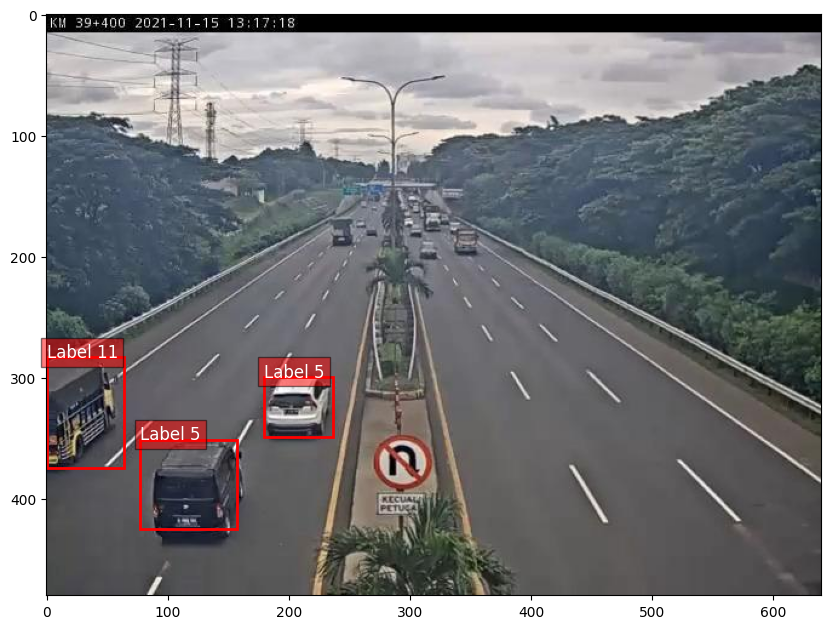

tensor(9)
tensor(10)
tensor(10)
tensor(8)
tensor(10)


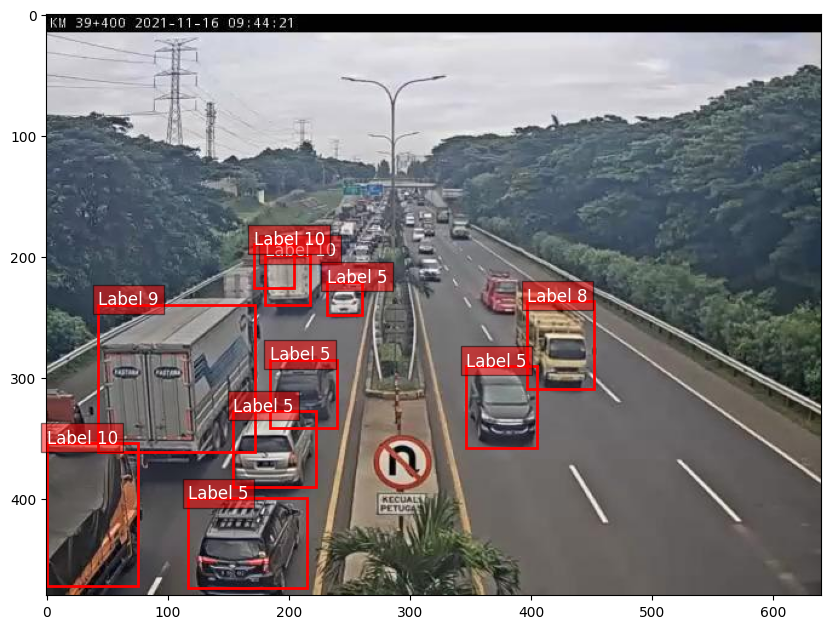

tensor(3)


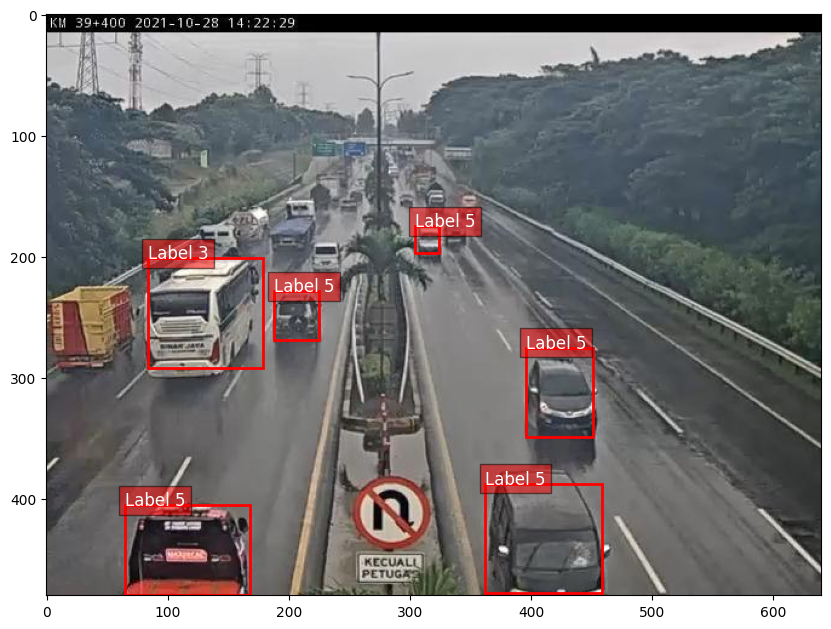

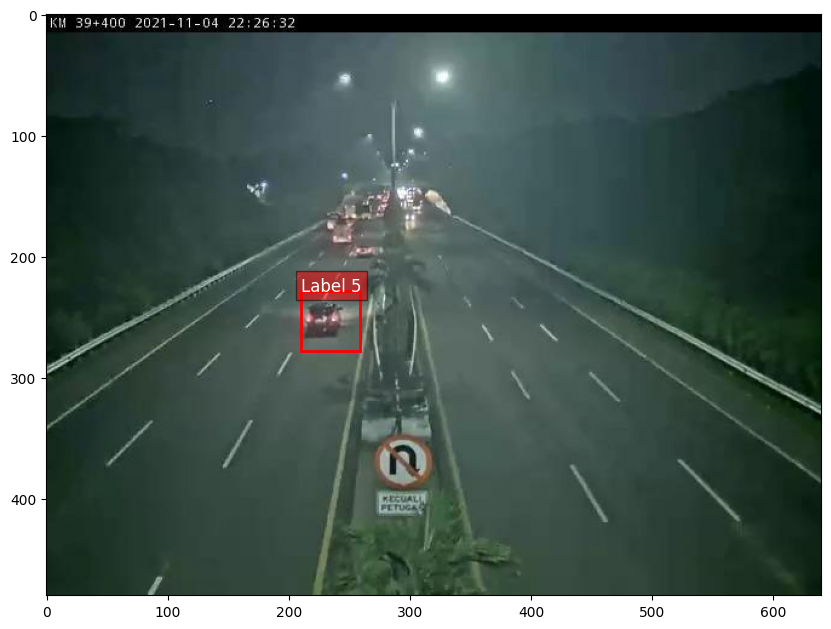

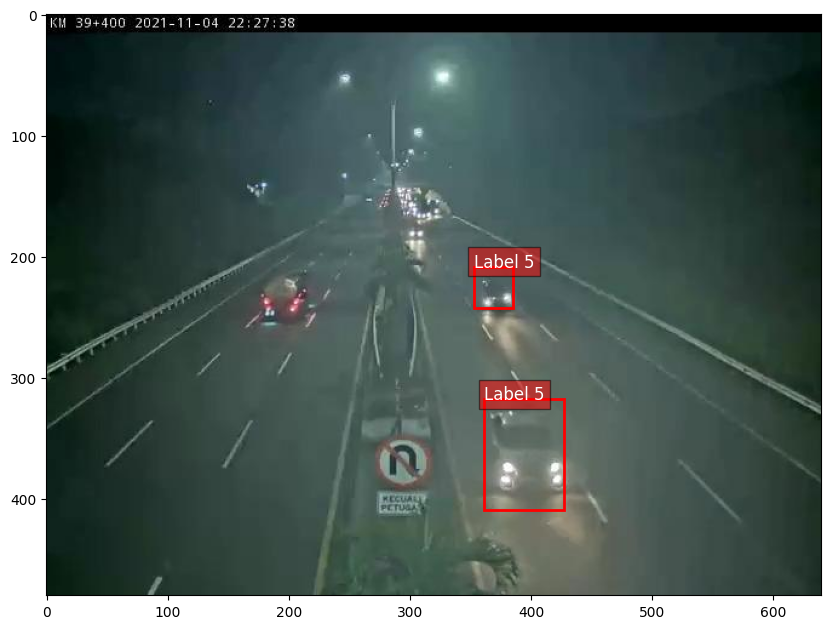

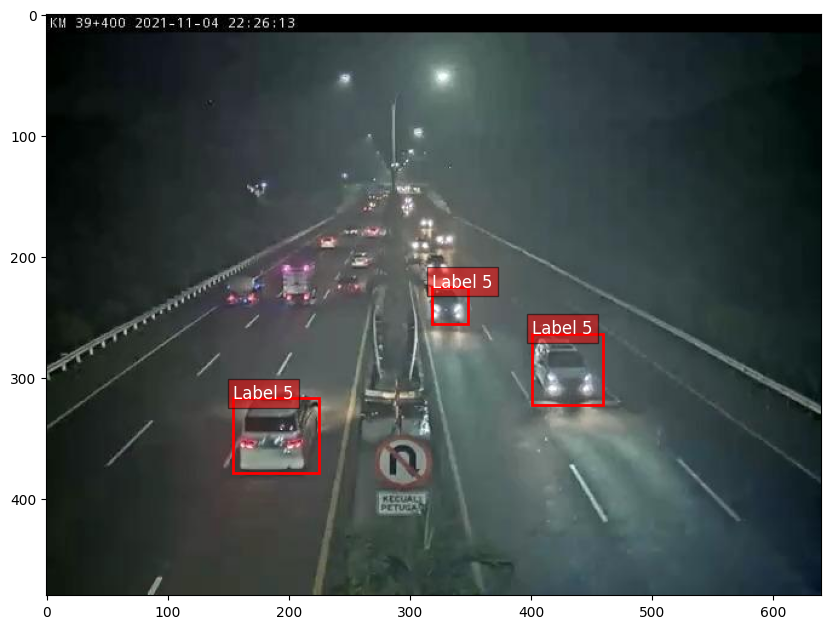

tensor(8)
tensor(2)
tensor(2)


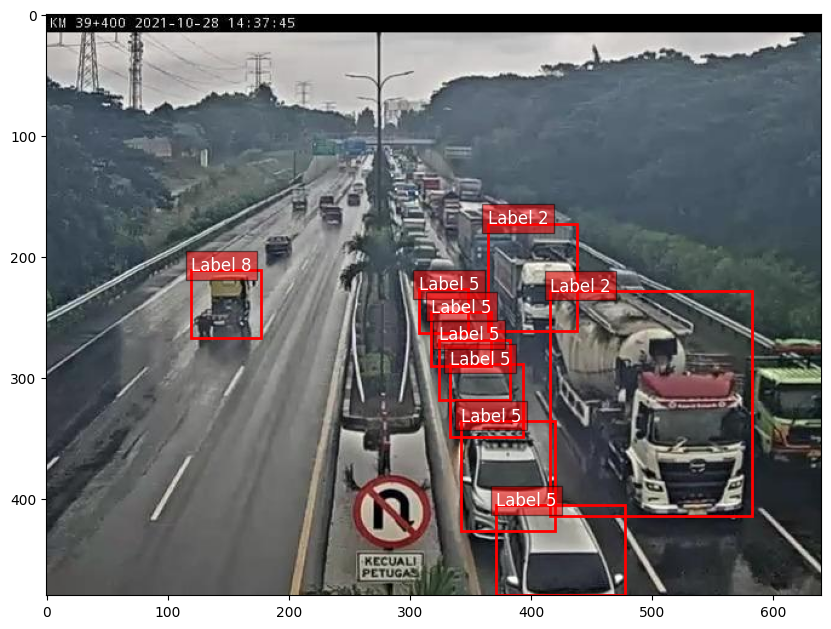

tensor(9)
tensor(10)
tensor(10)


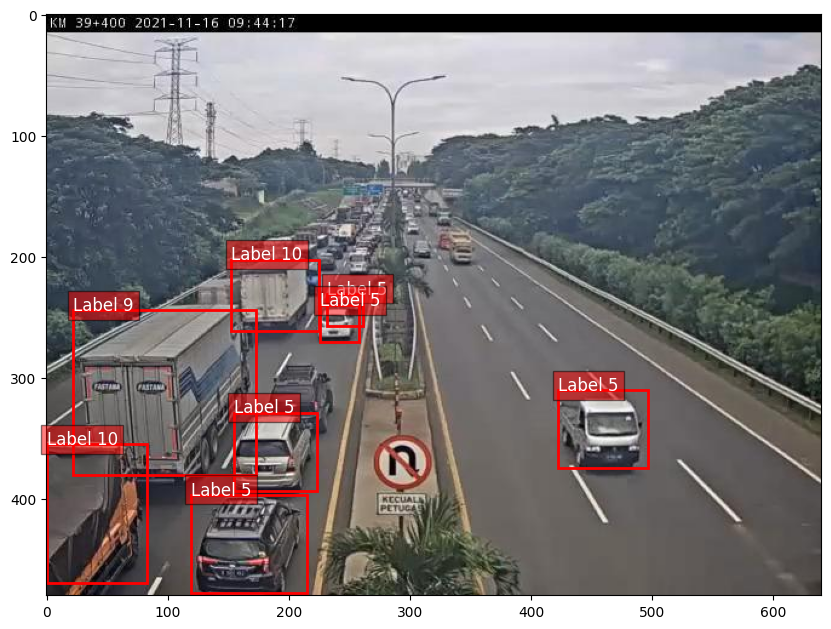

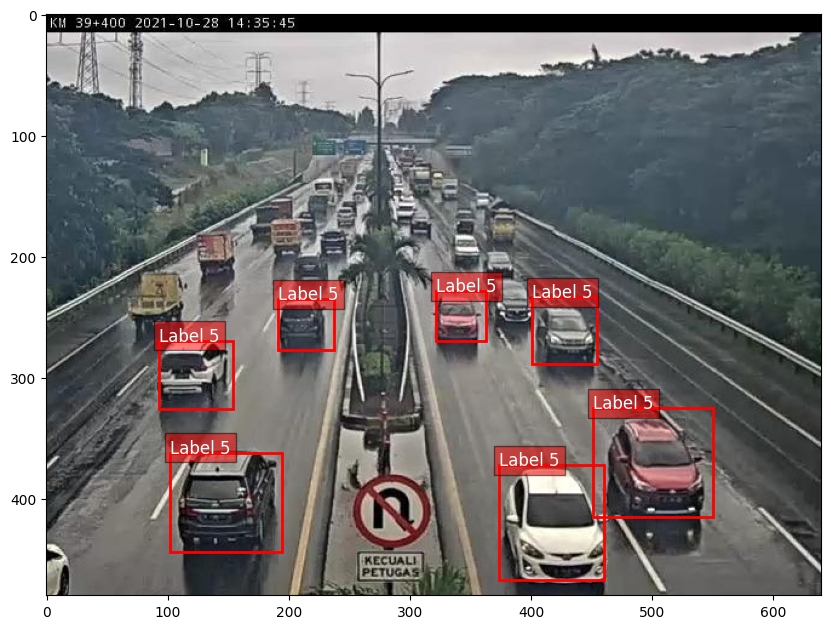

tensor(9)
tensor(8)


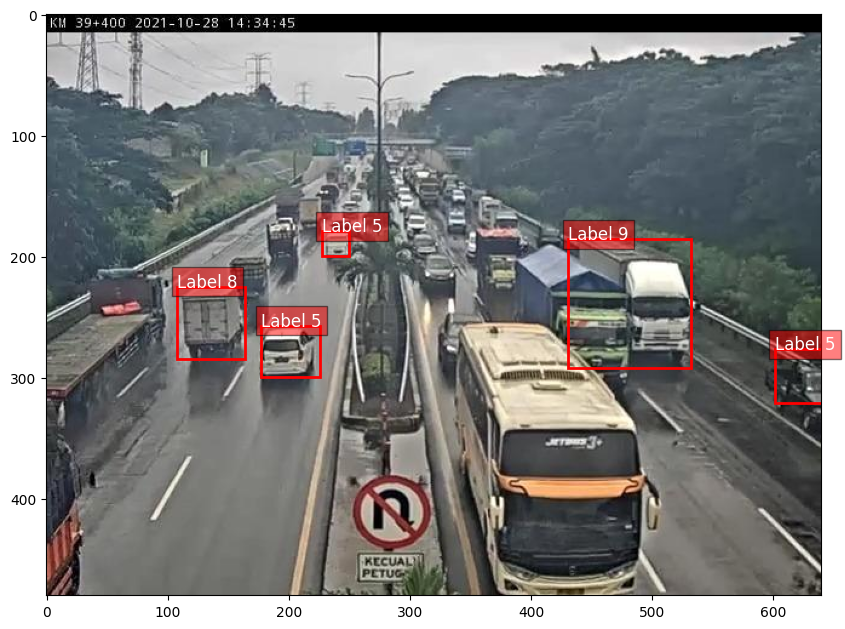

tensor(2)


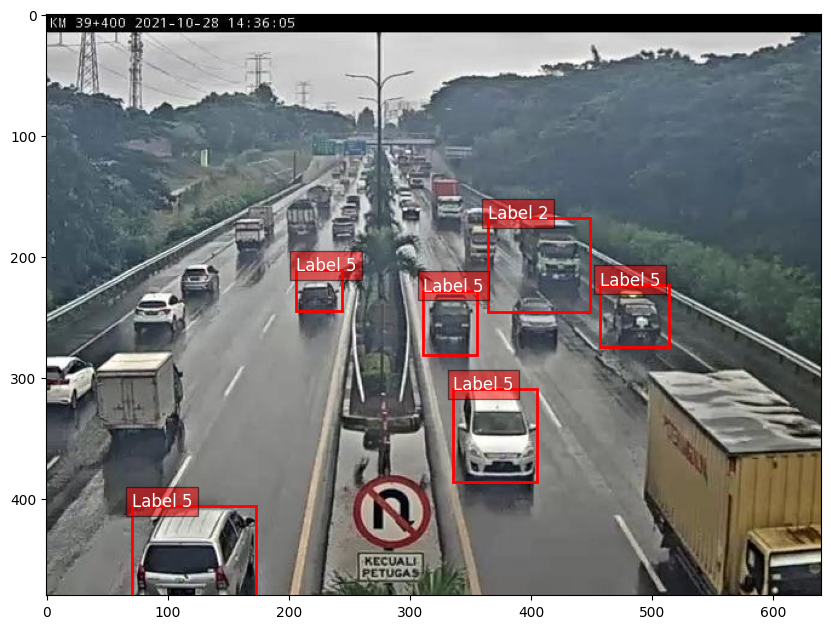

tensor(2)
tensor(2)
tensor(8)


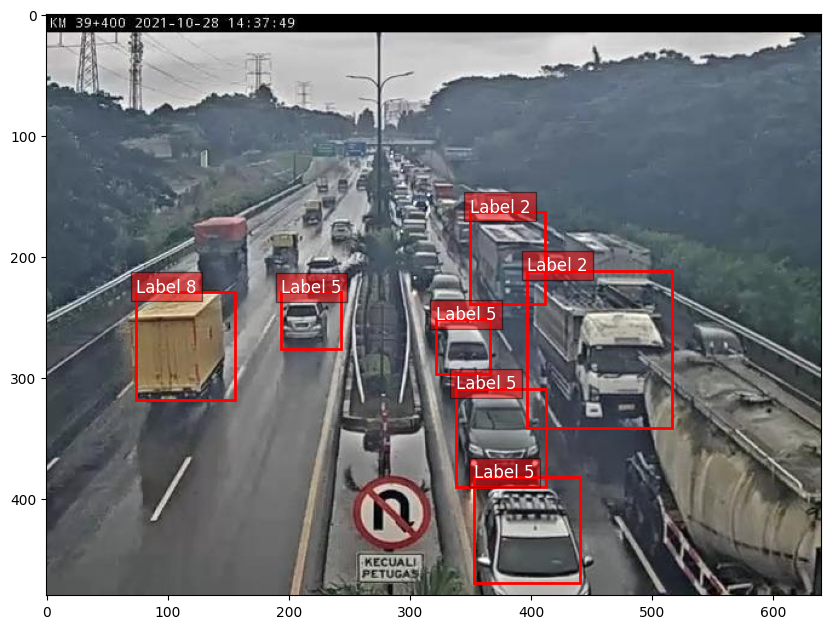

tensor(9)


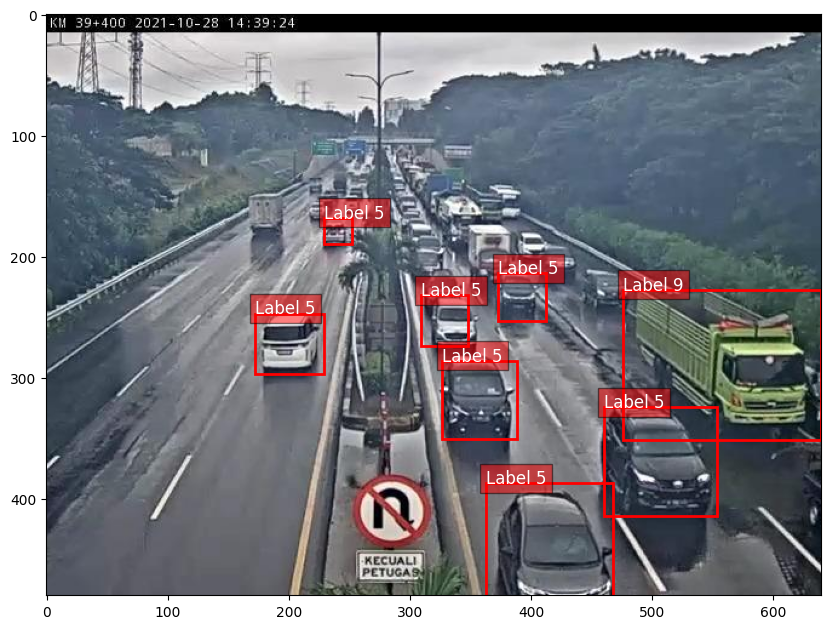

tensor(8)
tensor(10)
tensor(9)
tensor(9)
tensor(8)


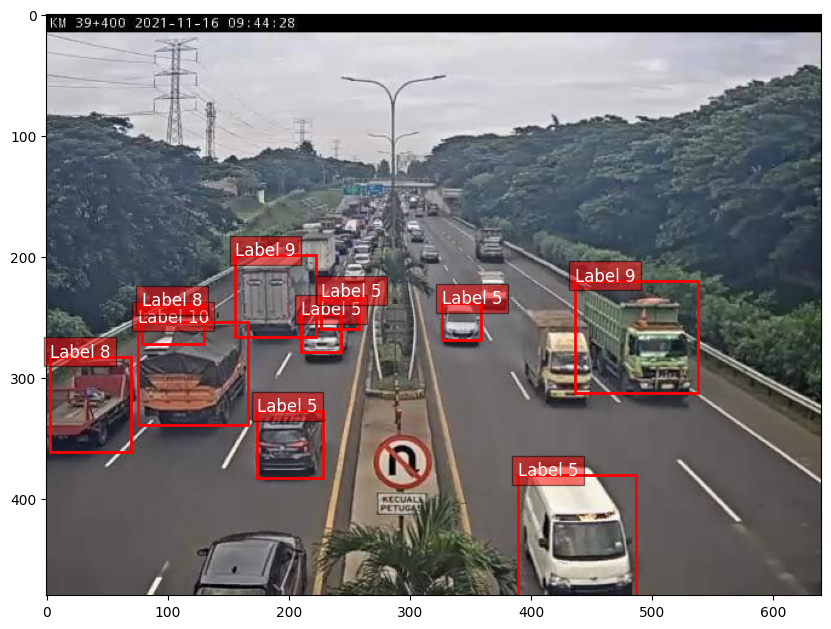

tensor(10)
tensor(9)
tensor(10)


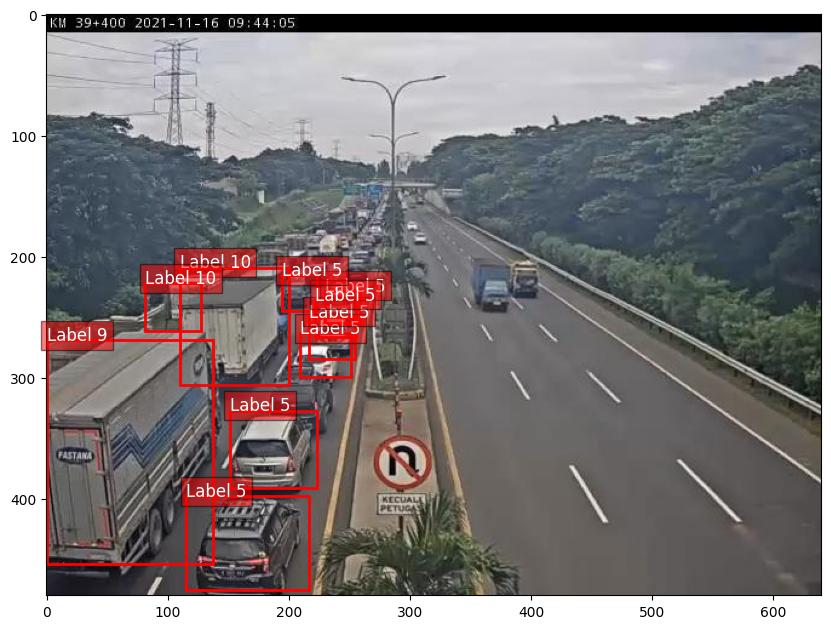

tensor(9)


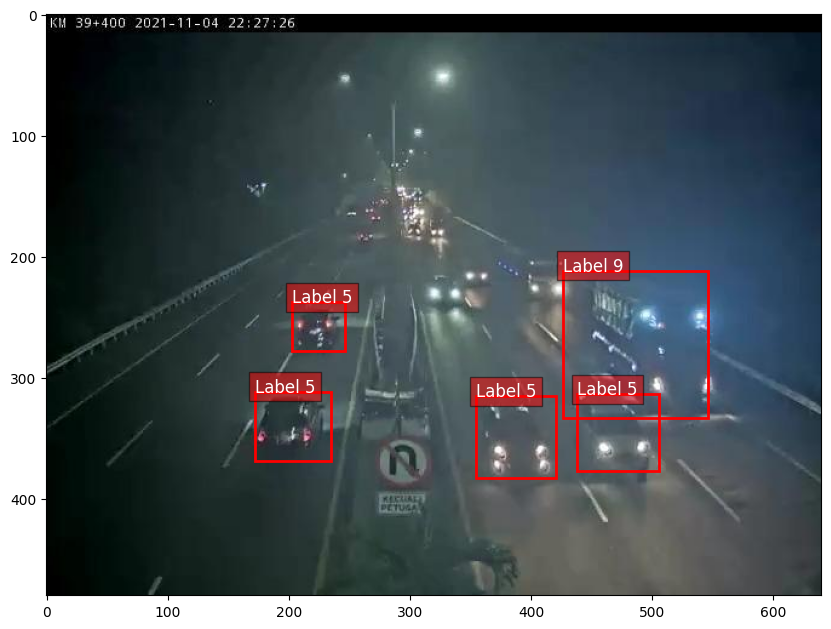

tensor(9)
tensor(1)


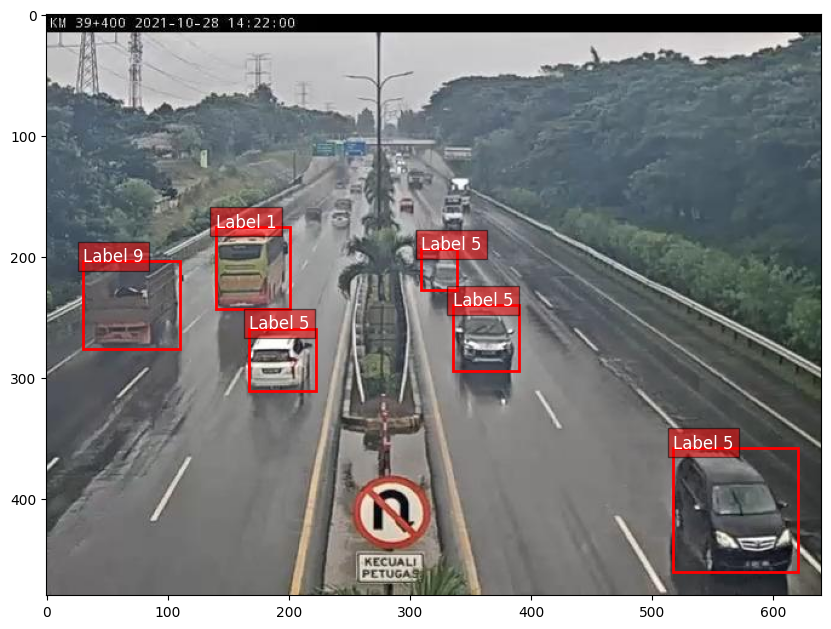

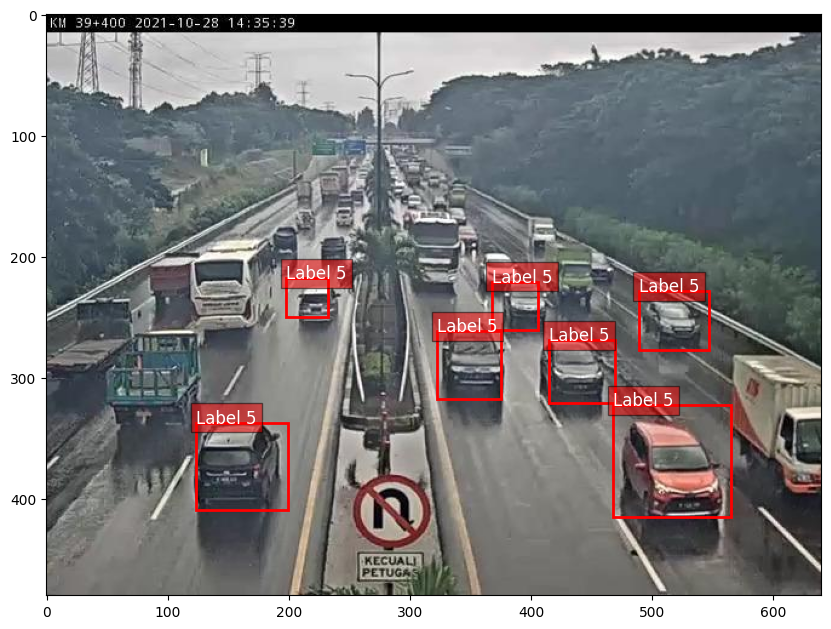

tensor(1)


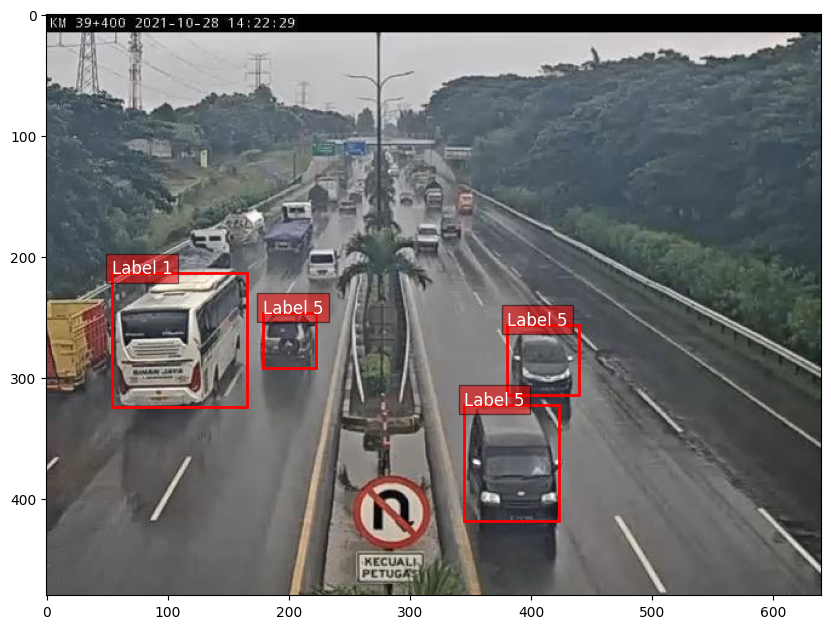

tensor(10)
tensor(10)


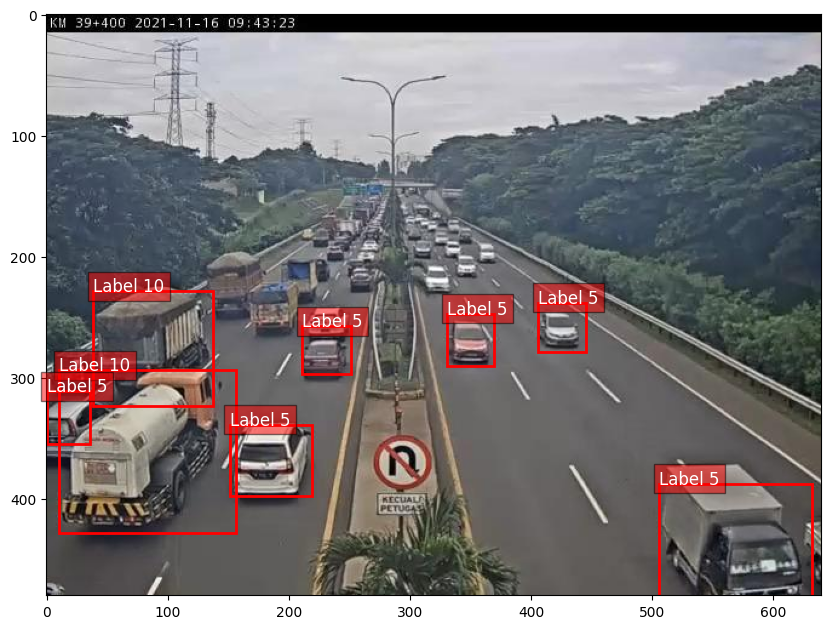

tensor(10)
tensor(10)
tensor(10)
tensor(10)
tensor(8)


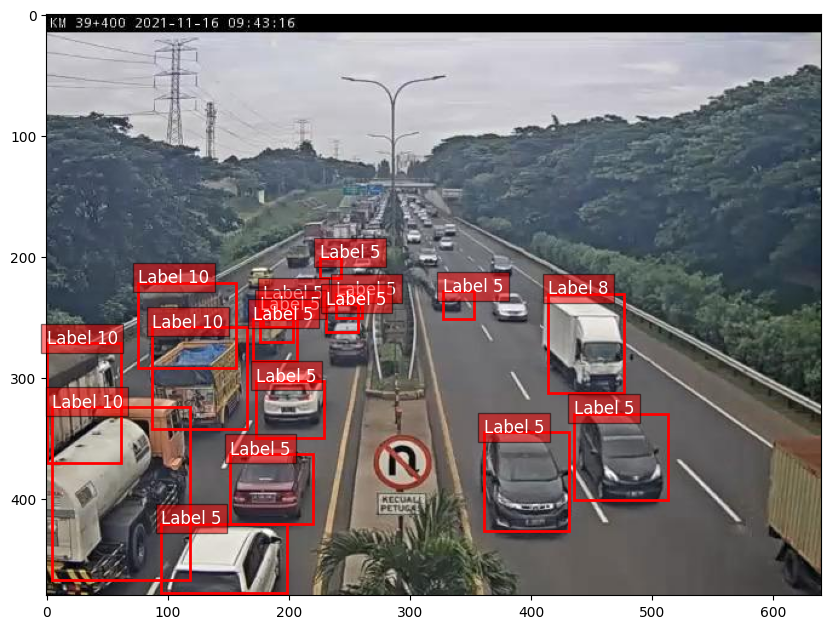

tensor(10)
tensor(2)


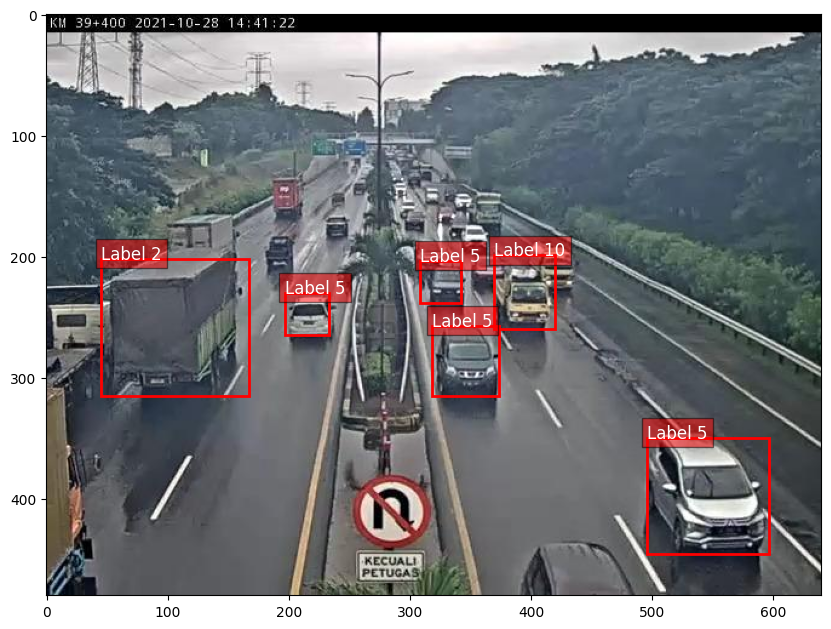

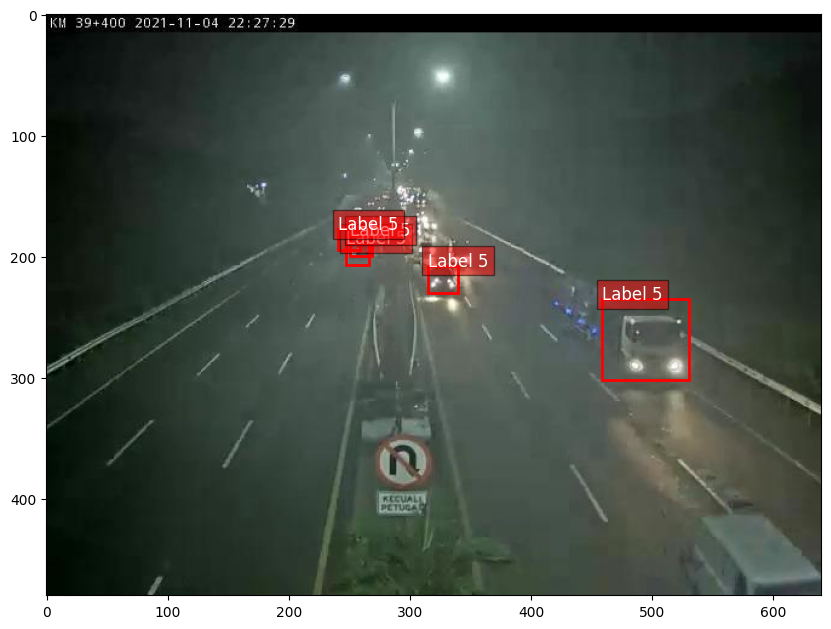

tensor(9)


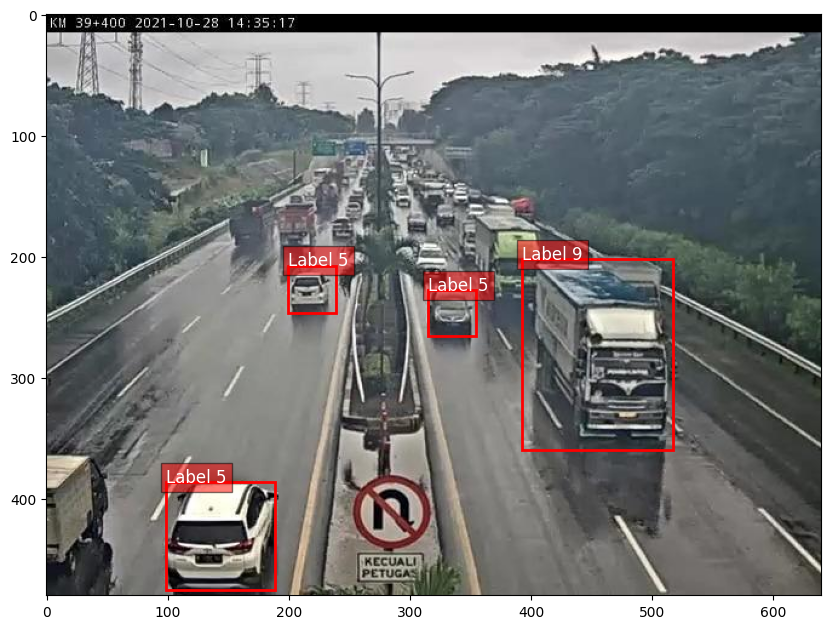

tensor(10)
tensor(10)


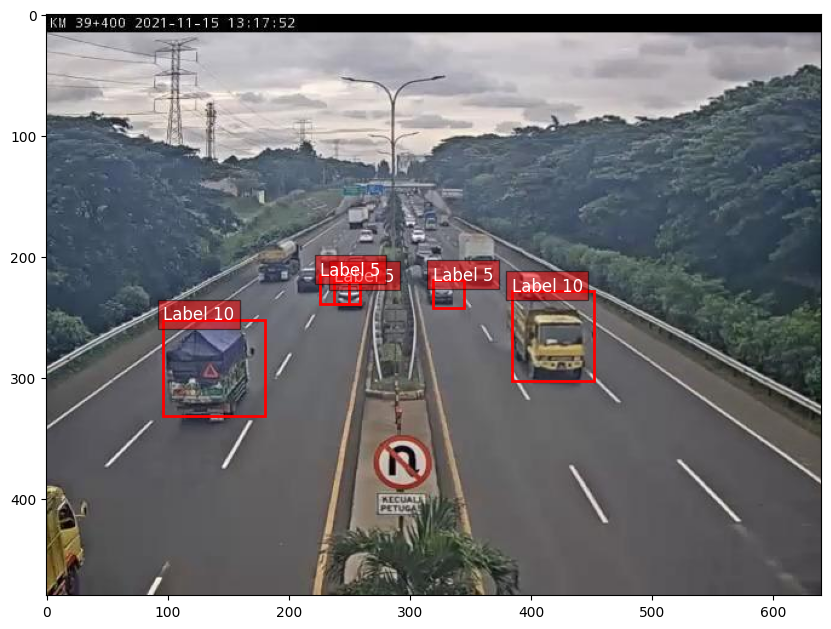

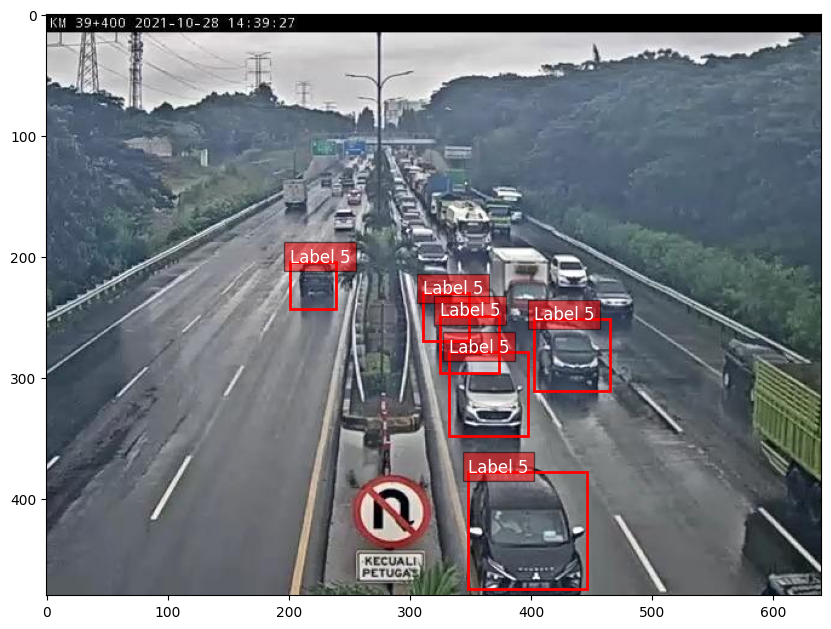

tensor(9)
tensor(3)
tensor(3)
tensor(9)
tensor(9)


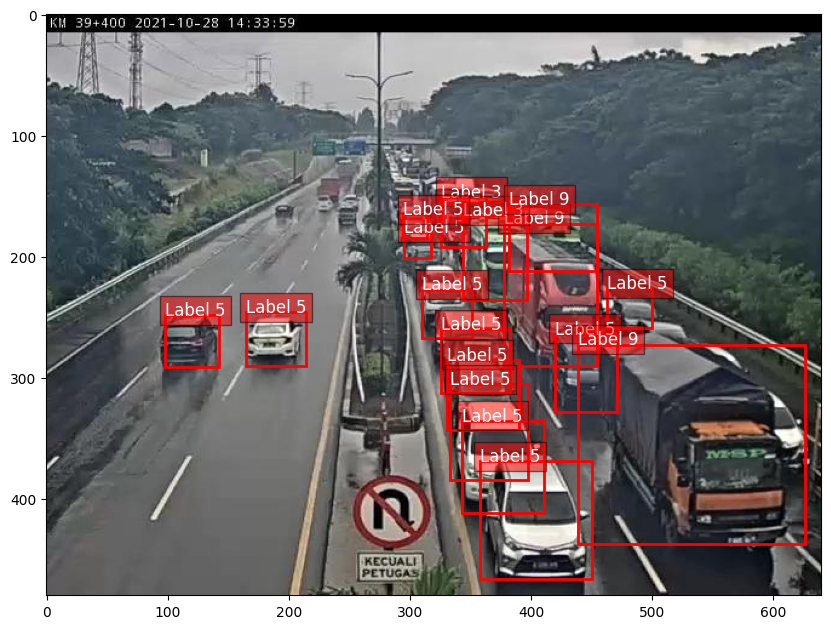

tensor(9)
tensor(10)
tensor(10)
tensor(10)


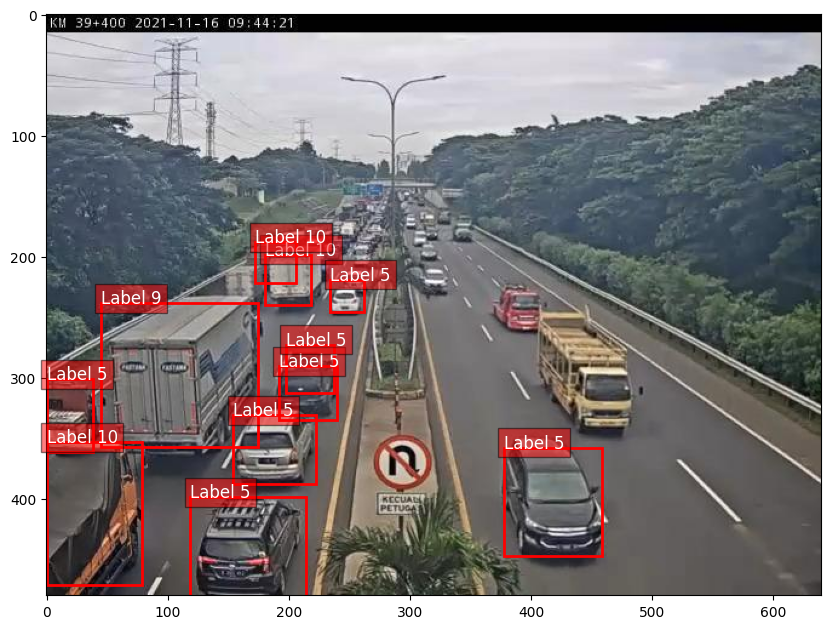

tensor(2)
tensor(9)
tensor(2)


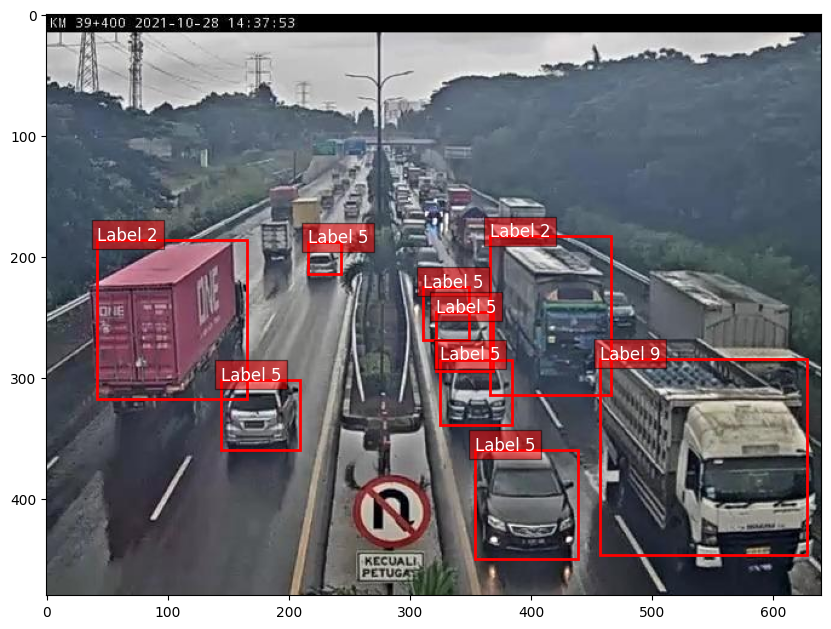

tensor(2)
tensor(2)
tensor(2)
tensor(8)


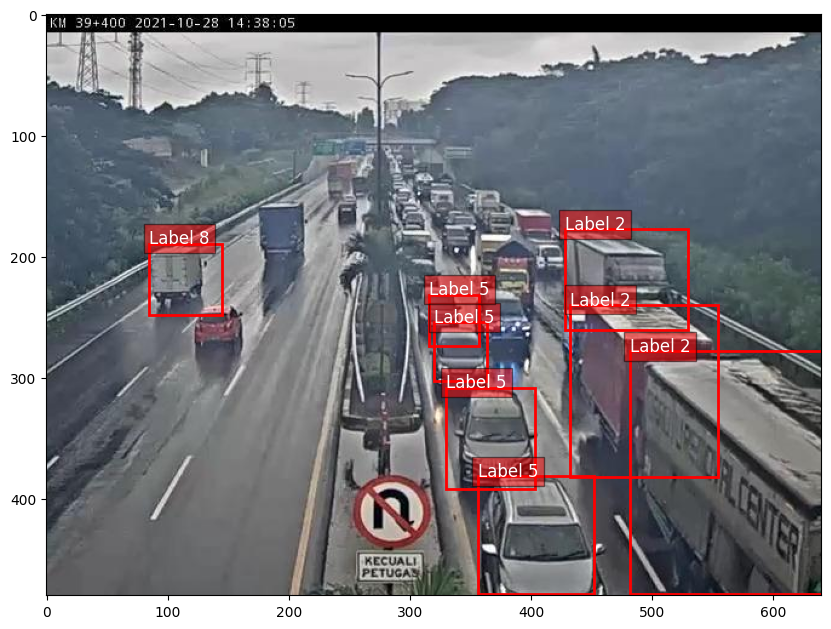

tensor(9)


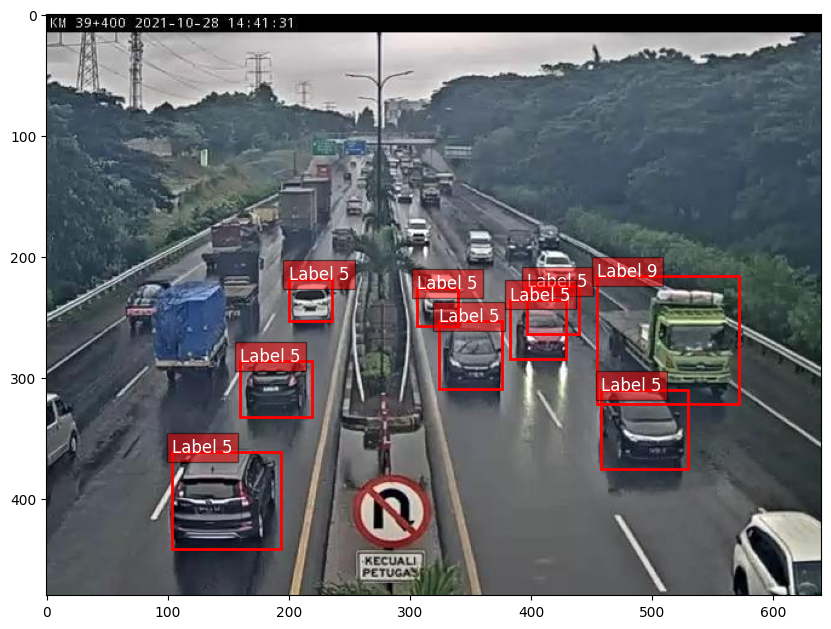

tensor(2)


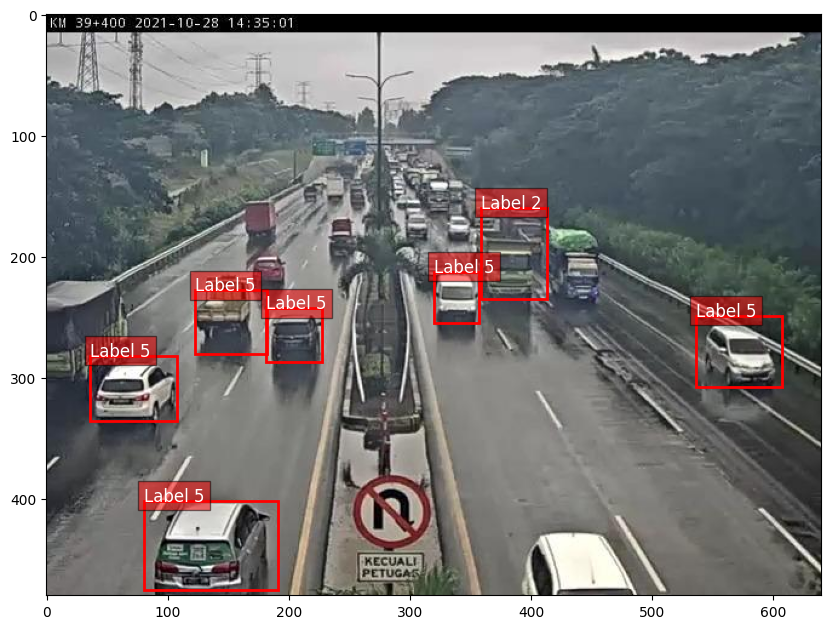

In [ ]:
images, predictions = get_model_predictions(
    model, val_loader, device, confidence_threshold=0.5, nms_threshold=0.4
)
visualize_predictions(images, predictions)

In [ ]:
import json

In [ ]:
with open("annotations/instances_train2017.json") as f:
    data = json.load(f)

In [ ]:
data["categories"]

[{'id': 0, 'name': 'vehicles', 'supercategory': 'none'},
 {'id': 1, 'name': 'big bus', 'supercategory': 'vehicles'},
 {'id': 2, 'name': 'big truck', 'supercategory': 'vehicles'},
 {'id': 3, 'name': 'bus-l-', 'supercategory': 'vehicles'},
 {'id': 4, 'name': 'bus-s-', 'supercategory': 'vehicles'},
 {'id': 5, 'name': 'car', 'supercategory': 'vehicles'},
 {'id': 6, 'name': 'mid truck', 'supercategory': 'vehicles'},
 {'id': 7, 'name': 'small bus', 'supercategory': 'vehicles'},
 {'id': 8, 'name': 'small truck', 'supercategory': 'vehicles'},
 {'id': 9, 'name': 'truck-l-', 'supercategory': 'vehicles'},
 {'id': 10, 'name': 'truck-m-', 'supercategory': 'vehicles'},
 {'id': 11, 'name': 'truck-s-', 'supercategory': 'vehicles'},
 {'id': 12, 'name': 'truck-xl-', 'supercategory': 'vehicles'}]

In [ ]:
for row in data["categories"]:
    print(f"{row['id']}: '{row['name']}',")

0: 'vehicles',
1: 'big bus',
2: 'big truck',
3: 'bus-l-',
4: 'bus-s-',
5: 'car',
6: 'mid truck',
7: 'small bus',
8: 'small truck',
9: 'truck-l-',
10: 'truck-m-',
11: 'truck-s-',
12: 'truck-xl-',


In [ ]:
torch.save(model.state_dict(), "MOBILE_RCNN.pth")